## Part 2: Stats of the Country Music Network
We begin with the necessary imports and after that the construction of the API url for the wiki page.

In [191]:
import urllib3, re, json, requests, random
import matplotlib.pyplot as plt
import networkx as nx
from urllib.parse import quote
import matplotlib as mpl
import numpy as np


baseurl = "https://en.wikipedia.org/w/api.php?"
action = "action=query"
title = "titles=List_of_country_music_performers"
content = "prop=revisions&rvprop=content"
dataform = "format=json"

query = "%s%s&%s&%s&%s" % (baseurl,action,title,content,dataform)

print(query)

https://en.wikipedia.org/w/api.php?action=query&titles=List_of_country_music_performers&prop=revisions&rvprop=content&format=json


Then we call this API to get this page's information. After its transformation into json format we convert it to a string form in order for us to be able to extract the performers links.

In [192]:
http = urllib3.PoolManager()

wikiresponse = http.request('GET', query)
wikisource = wikiresponse.data.decode('utf-8')

wikijson = json.loads(wikisource)

text = wikijson["query"]["pages"]
wiki_text = json.dumps(text)

In [193]:
wiki_text

'{"328877": {"pageid": 328877, "ns": 0, "title": "List of country music performers", "revisions": [{"contentformat": "text/x-wiki", "contentmodel": "wikitext", "*": "{{Short description|none}}\\n{{see also|Country music|List of country performers by era|List of Country Music Hall of Fame inductees|Popular music|List of popular music performers}}\\n\\nThis is an alphabetical list of \'\'\'country music performers\'\'\'. It includes artists who played [[country music]] at some point in their career, even if they were not exclusively country music performers.\\n{{Dynamic list}}\\n{{compact TOC|side=yes|top=yes|num=yes}}__NOTOC__\\n\\n==0-9==\\n\\n\\n{{columns-list|colwidth=30em|\\n*[[3 of Hearts (band)|3 of Hearts]]\\n*[[4 Runner]]\\n*[[8 Ball Aitken]]\\n}}\\n\\n==A==\\n[[File:Gene Autry.JPG|thumb|right|140px|[[Gene Autry]]]]\\n[[File:Eddie Arnold 1969.JPG|thumb|right|140px|[[Eddy Arnold]]]]\\n[[File:Roy Acuff 1950.JPG|thumb|right|140px|[[Roy Acuff]]]]\\n[[File:Rodney Atkins pointing up.j

Now we are going to use regex on this string in order to extract only the needed information, which in this case are the performers links. We can see that all the words that are a link are inside double brackets (for example [[The Abrams Brothers]]). Thus, it will be easy to extract all the links using "findall".

In [194]:
results = re.findall(r"\[\[(.*?)\]\]", wiki_text)

results

['country music',
 '3 of Hearts (band)|3 of Hearts',
 '4 Runner',
 '8 Ball Aitken',
 'File:Gene Autry.JPG|thumb|right|140px|[[Gene Autry',
 'File:Eddie Arnold 1969.JPG|thumb|right|140px|[[Eddy Arnold',
 'File:Roy Acuff 1950.JPG|thumb|right|140px|[[Roy Acuff',
 'File:Rodney Atkins pointing up.jpg|thumb|right|140px|[[Rodney Atkins',
 'The Abrams Brothers',
 'Ace in the Hole Band',
 'Roy Acuff',
 'Kay Adams (singer)|Kay Adams',
 'Ryan Adams',
 'Doug Adkins',
 'Trace Adkins',
 'David \\"Stringbean\\" Akeman',
 'Rhett Akins',
 'Alabama (band)|Alabama',
 'Lauren Alaina',
 'Jason Aldean',
 'Alee (singer)|Alee',
 'Daniele Alexander',
 'Jessi Alexander',
 'Gary Allan',
 'Susie Allanson',
 'Deborah Allen',
 'Duane Allen',
 'Harley Allen',
 'Jimmie Allen',
 'Rex Allen',
 'Terry Allen (country singer)|Terry Allen',
 'Allman Brothers Band',
 'Gregg Allman',
 'Tommy Alverson',
 'Dave Alvin',
 'Amazing Rhythm Aces',
 'American Young',
 'Don Amero',
 'Colin Amey',
 'Al Anderson (NRBQ)|Al Anderson',
 '

Now, we have to do some cleaning to the names of the performers. First and foremost, we are replacing all white spaces with underscores, otherwise when we transform these names into URLs we might not be able to find all of the pages. Furthermore, there are many images and other file links in the performer list page, which we can just remove them.

In [195]:
cleaned_data = [name.replace(" ", "_") for name in results if not (name.startswith("File:") or name.startswith("Image:"))]
cleaned_data = cleaned_data[1:]
cleaned_data

['3_of_Hearts_(band)|3_of_Hearts',
 '4_Runner',
 '8_Ball_Aitken',
 'The_Abrams_Brothers',
 'Ace_in_the_Hole_Band',
 'Roy_Acuff',
 'Kay_Adams_(singer)|Kay_Adams',
 'Ryan_Adams',
 'Doug_Adkins',
 'Trace_Adkins',
 'David_\\"Stringbean\\"_Akeman',
 'Rhett_Akins',
 'Alabama_(band)|Alabama',
 'Lauren_Alaina',
 'Jason_Aldean',
 'Alee_(singer)|Alee',
 'Daniele_Alexander',
 'Jessi_Alexander',
 'Gary_Allan',
 'Susie_Allanson',
 'Deborah_Allen',
 'Duane_Allen',
 'Harley_Allen',
 'Jimmie_Allen',
 'Rex_Allen',
 'Terry_Allen_(country_singer)|Terry_Allen',
 'Allman_Brothers_Band',
 'Gregg_Allman',
 'Tommy_Alverson',
 'Dave_Alvin',
 'Amazing_Rhythm_Aces',
 'American_Young',
 'Don_Amero',
 'Colin_Amey',
 'Al_Anderson_(NRBQ)|Al_Anderson',
 'Bill_Anderson_(singer)|Bill_Anderson',
 'Brent_Anderson_(singer)|Brent_Anderson',
 'Coffey_Anderson',
 'John_Anderson_(singer)|John_Anderson',
 'Keith_Anderson',
 'Liz_Anderson',
 'Lynn_Anderson',
 'Sharon_Anderson_(singer)|Sharon_Anderson',
 'Elisabeth_Andreassen',


Many performers have special characters, but since there are so many it is a kind of the trouble to find all of them. Just by looking at the names, the most common one is double backslash "\\\\", which we are going to remove. Also, some names have a vertical bar "|" and after that bar the simple name is represented, but after testing it out it has no influence in the construction of the performer names URLs, so there is no need to remove it. Last but not least, we noticed that some performers' URL do not actually have the name shown in the list above, but it is impossible to go one by one and check every performer's link.

In [196]:
list_of_singers = [name.replace("\\", "") for name in cleaned_data]
list_of_singers

['3_of_Hearts_(band)|3_of_Hearts',
 '4_Runner',
 '8_Ball_Aitken',
 'The_Abrams_Brothers',
 'Ace_in_the_Hole_Band',
 'Roy_Acuff',
 'Kay_Adams_(singer)|Kay_Adams',
 'Ryan_Adams',
 'Doug_Adkins',
 'Trace_Adkins',
 'David_"Stringbean"_Akeman',
 'Rhett_Akins',
 'Alabama_(band)|Alabama',
 'Lauren_Alaina',
 'Jason_Aldean',
 'Alee_(singer)|Alee',
 'Daniele_Alexander',
 'Jessi_Alexander',
 'Gary_Allan',
 'Susie_Allanson',
 'Deborah_Allen',
 'Duane_Allen',
 'Harley_Allen',
 'Jimmie_Allen',
 'Rex_Allen',
 'Terry_Allen_(country_singer)|Terry_Allen',
 'Allman_Brothers_Band',
 'Gregg_Allman',
 'Tommy_Alverson',
 'Dave_Alvin',
 'Amazing_Rhythm_Aces',
 'American_Young',
 'Don_Amero',
 'Colin_Amey',
 'Al_Anderson_(NRBQ)|Al_Anderson',
 'Bill_Anderson_(singer)|Bill_Anderson',
 'Brent_Anderson_(singer)|Brent_Anderson',
 'Coffey_Anderson',
 'John_Anderson_(singer)|John_Anderson',
 'Keith_Anderson',
 'Liz_Anderson',
 'Lynn_Anderson',
 'Sharon_Anderson_(singer)|Sharon_Anderson',
 'Elisabeth_Andreassen',
 'In

So, now we can start getting the information of every performer in the list. We do that with a loop where the API of each performer is build and using it we get the page's information, which is transformed into a string. The result of this loop is a list of all the performer names and their information in json format converted to text. 

In [197]:
performer_text = {}

for singer in list_of_singers: 
    baseurl = "https://en.wikipedia.org/w/api.php?"
    action = "action=query"
    title = f"titles={quote(singer)}"  
    content = "prop=revisions&rvprop=content"
    dataform = "format=json"
    
    query = f"{baseurl}{action}&{title}&{content}&{dataform}"
    
    response = requests.get(query)
    
    if response.status_code == 200:
        #imported code from previously
        wikiresponse = http.request('GET', query)
        wikisource = wikiresponse.data.decode('utf-8')
        wikijson = json.loads(wikisource)
        text = wikijson["query"]["pages"]
        wiki_text = json.dumps(text)
        
        #results = re.findall(r"\[\[(.*?)\]\]", wiki_text)

        performer_text[singer] = wiki_text
        
    else:
        print(f"Error fetching data for {singer}: {response.status_code}")
    
performer_text

{'3_of_Hearts_(band)|3_of_Hearts': '{"10855764": {"pageid": 10855764, "ns": 0, "title": "3 of Hearts", "revisions": [{"contentformat": "text/x-wiki", "contentmodel": "wikitext", "*": "{{Short description|American country music trio}}\\n{{other uses|Three of hearts (disambiguation)}}\\n{{Infobox musical artist\\n| name            = 3 of Hearts\\n| image           =\\n| alt             =\\n| caption         =\\n| alias           = Three of Hearts\\n| origin          = [[Fort Worth, Texas]], United States\\n| genre           = [[country music|Country]]\\n| years_active    = 2001\\u20132005\\n| label           = [[RCA Records Nashville|RCA Nashville]]\\n| past_members    = {{Unbulleted list|Blaire Stroud|Katie McNeill|Deserea Wasdin}}\\n}}\\n\\n\'\'\'3 of Hearts\'\'\' was an American [[country music]] trio composed of Blaire Stroud, Katie McNeill, and Deserea Wasdin, all natives of [[Fort Worth, Texas]]. Signed to [[RCA Records Nashville|RCA Nashville]] in 2001, the trio released its debut

Now we can use regex again and extract all the links in each performer wiki page using findall.

In [198]:
performer_contents = {}

for performer, content in performer_text.items():
    performer_contents[performer] = re.findall(r"\[\[(.*?)\]\]", content)

performer_contents

{'3_of_Hearts_(band)|3_of_Hearts': ['Fort Worth, Texas',
  'country music|Country',
  'RCA Records Nashville|RCA Nashville',
  'country music',
  'Fort Worth, Texas',
  'RCA Records Nashville|RCA Nashville',
  'Hot Country Singles & Tracks',
  'The Christmas Shoes (song)#Cover versions and other media|The Christmas Shoes',
  'L.D. Bell High School',
  'demo tape',
  'RCA Records Nashville|RCA Nashville',
  'Seventeen (American magazine)|Seventeen',
  'Allmusic',
  'Hot Country Singles & Tracks',
  'The Christmas Shoes (song)|The Christmas Shoes',
  'Top Country Albums|US Country',
  '3 of Hearts (album)|3 of Hearts',
  'RCA Records Nashville|RCA Nashville',
  'Compact disc|CD',
  'Hot Country Songs|US Country',
  'The Christmas Shoes (song)|The Christmas Shoes',
  'Category:Country music groups from Texas',
  'Category:American girl groups',
  'Category:Musical groups established in 2001',
  'Category:Musical groups disestablished in 2005',
  'Category:2001 establishments in Texas',
  

We go again for the same transformation for the links, in order for them to be in the same form as the performer names. Thus, if a link is another performer's name we can find it and match it easily.

In [199]:
for performer, links in performer_contents.items():
        new_values = [link.replace(" ", "_").replace("\\", "") for link in links]
        
        performer_contents[performer] = new_values
        
performer_contents

{'3_of_Hearts_(band)|3_of_Hearts': ['Fort_Worth,_Texas',
  'country_music|Country',
  'RCA_Records_Nashville|RCA_Nashville',
  'country_music',
  'Fort_Worth,_Texas',
  'RCA_Records_Nashville|RCA_Nashville',
  'Hot_Country_Singles_&_Tracks',
  'The_Christmas_Shoes_(song)#Cover_versions_and_other_media|The_Christmas_Shoes',
  'L.D._Bell_High_School',
  'demo_tape',
  'RCA_Records_Nashville|RCA_Nashville',
  'Seventeen_(American_magazine)|Seventeen',
  'Allmusic',
  'Hot_Country_Singles_&_Tracks',
  'The_Christmas_Shoes_(song)|The_Christmas_Shoes',
  'Top_Country_Albums|US_Country',
  '3_of_Hearts_(album)|3_of_Hearts',
  'RCA_Records_Nashville|RCA_Nashville',
  'Compact_disc|CD',
  'Hot_Country_Songs|US_Country',
  'The_Christmas_Shoes_(song)|The_Christmas_Shoes',
  'Category:Country_music_groups_from_Texas',
  'Category:American_girl_groups',
  'Category:Musical_groups_established_in_2001',
  'Category:Musical_groups_disestablished_in_2005',
  'Category:2001_establishments_in_Texas',
  

So now we do the matching of links with the performer names and store all the matched pairs in a list.

In [200]:
matches = []
    
for performer, links in performer_contents.items():
    for link in links:
        if link in performer_contents:
            matches.append((performer, link))
                   
matches

[('4_Runner', 'Tanya_Tucker'),
 ('4_Runner', 'Diamond_Rio'),
 ('4_Runner', 'Reba_McEntire'),
 ('4_Runner', 'Amie_Comeaux'),
 ('4_Runner', 'Michael_Johnson_(singer)|Michael_Johnson'),
 ('4_Runner', 'Poco_(band)|Poco'),
 ('4_Runner', 'Great_Plains_(Tennessee_band)|Great_Plains'),
 ('4_Runner', 'Chely_Wright'),
 ('4_Runner', 'Keith_Urban'),
 ('4_Runner', 'Chad_Brock'),
 ('4_Runner', 'The_Jenkins'),
 ('4_Runner', 'Craig_Morgan'),
 ('4_Runner', 'Loretta_Lynn'),
 ('Ace_in_the_Hole_Band', 'George_Strait'),
 ('Ace_in_the_Hole_Band', 'Darrell_McCall'),
 ('Ace_in_the_Hole_Band', 'Mel_Tillis'),
 ('Ace_in_the_Hole_Band', 'Bob_Wills'),
 ('Ace_in_the_Hole_Band', 'Johnny_Bush'),
 ('Ace_in_the_Hole_Band', 'Asleep_at_the_Wheel'),
 ('Ace_in_the_Hole_Band', 'Jerry_Jeff_Walker'),
 ('Ace_in_the_Hole_Band', 'Asleep_at_the_Wheel'),
 ('Ace_in_the_Hole_Band', 'Jerry_Jeff_Walker'),
 ('Ace_in_the_Hole_Band', 'Dallas_Frazier'),
 ('Ace_in_the_Hole_Band', 'Darrell_McCall'),
 ('Ace_in_the_Hole_Band', 'Mel_Tillis'),


And remove the duplicates.

In [201]:
matches = list(set(matches))

In [202]:
matches

[('Lloyd_Maines', 'Uncle_Tupelo'),
 ('Taylor_Ware', 'Margo_Smith'),
 ('Claude_King', 'Johnny_Cash'),
 ('Neil_Thrasher', '3_of_Hearts_(band)|3_of_Hearts'),
 ('Billy_Burnette', 'Ricky_Nelson'),
 ('Michelle_Nixon', 'Rhonda_Vincent'),
 ('Dwight_Yoakam', 'Roy_Orbison'),
 ('Lori_McKenna', 'Tim_McGraw'),
 ('Tony_Booth_(musician)|Tony_Booth', 'Merle_Haggard'),
 ('Drake_Jensen', 'Anne_Murray'),
 ('Matthew_Ramsey', 'Dierks_Bentley'),
 ('Bob_Dylan', 'Kris_Kristofferson'),
 ('Jerry_Kilgore_(singer)|Jerry_Kilgore', 'Randy_Travis'),
 ('Shania_Twain', 'Travis_Tritt'),
 ('Brothers_Osborne', 'Lee_Ann_Womack'),
 ('Nickel_Creek', 'Vince_Gill'),
 ('Kristin_Chenoweth', 'Dolly_Parton'),
 ('Super_Grit_Cowboy_Band', 'Robert_Ellis_Orrall'),
 ('Calamity_Jane_(country_music_band)|Calamity_Jane', 'Lee_Greenwood'),
 ('Lindsay_Ell', 'Les_Paul'),
 ('Victoria_Banks', 'Jess_Moskaluke'),
 ('Ray_Charles', 'Van_Morrison'),
 ('Cale_Dodds', 'Brett_Eldredge'),
 ('Don_Cox_(singer)|Don_Cox', 'Super_Grit_Cowboy_Band'),
 ('Midl

Now, we are ready to start building the network, which has the performer names as nodes and the matched pairs as directed edges. 

In [203]:
G = nx.DiGraph()
G.add_nodes_from(performer_contents.keys())
G.add_edges_from(matches)

In [204]:
G.nodes()

NodeView(('3_of_Hearts_(band)|3_of_Hearts', '4_Runner', '8_Ball_Aitken', 'The_Abrams_Brothers', 'Ace_in_the_Hole_Band', 'Roy_Acuff', 'Kay_Adams_(singer)|Kay_Adams', 'Ryan_Adams', 'Doug_Adkins', 'Trace_Adkins', 'David_"Stringbean"_Akeman', 'Rhett_Akins', 'Alabama_(band)|Alabama', 'Lauren_Alaina', 'Jason_Aldean', 'Alee_(singer)|Alee', 'Daniele_Alexander', 'Jessi_Alexander', 'Gary_Allan', 'Susie_Allanson', 'Deborah_Allen', 'Duane_Allen', 'Harley_Allen', 'Jimmie_Allen', 'Rex_Allen', 'Terry_Allen_(country_singer)|Terry_Allen', 'Allman_Brothers_Band', 'Gregg_Allman', 'Tommy_Alverson', 'Dave_Alvin', 'Amazing_Rhythm_Aces', 'American_Young', 'Don_Amero', 'Colin_Amey', 'Al_Anderson_(NRBQ)|Al_Anderson', 'Bill_Anderson_(singer)|Bill_Anderson', 'Brent_Anderson_(singer)|Brent_Anderson', 'Coffey_Anderson', 'John_Anderson_(singer)|John_Anderson', 'Keith_Anderson', 'Liz_Anderson', 'Lynn_Anderson', 'Sharon_Anderson_(singer)|Sharon_Anderson', 'Elisabeth_Andreassen', 'Ingrid_Andress', 'Courtney_Marie_Andr

In [205]:
G.edges()

OutEdgeView([('4_Runner', 'Tanya_Tucker'), ('4_Runner', 'Amie_Comeaux'), ('4_Runner', 'The_Jenkins'), ('4_Runner', 'Chad_Brock'), ('4_Runner', 'Diamond_Rio'), ('4_Runner', 'Chely_Wright'), ('4_Runner', 'Keith_Urban'), ('4_Runner', 'Poco_(band)|Poco'), ('4_Runner', 'Michael_Johnson_(singer)|Michael_Johnson'), ('4_Runner', 'Loretta_Lynn'), ('4_Runner', 'Great_Plains_(Tennessee_band)|Great_Plains'), ('4_Runner', 'Reba_McEntire'), ('4_Runner', 'Craig_Morgan'), ('Ace_in_the_Hole_Band', 'Bob_Wills'), ('Ace_in_the_Hole_Band', 'Hank_Williams'), ('Ace_in_the_Hole_Band', 'Dallas_Frazier'), ('Ace_in_the_Hole_Band', 'Jerry_Jeff_Walker'), ('Ace_in_the_Hole_Band', 'Tim_Mensy'), ('Ace_in_the_Hole_Band', 'George_Strait'), ('Ace_in_the_Hole_Band', 'Darrell_McCall'), ('Ace_in_the_Hole_Band', 'Mel_Tillis'), ('Ace_in_the_Hole_Band', 'Merle_Haggard'), ('Ace_in_the_Hole_Band', 'George_Jones'), ('Ace_in_the_Hole_Band', 'Asleep_at_the_Wheel'), ('Ace_in_the_Hole_Band', 'Johnny_Bush'), ('Roy_Acuff', 'Nitty_Grit

In [206]:
print("Total number of nodes:", G.number_of_nodes())
print("Total number of edges:", G.number_of_edges())

Total number of nodes: 2103
Total number of edges: 17509


Let's get started with the statistics now. First, let's plot the distributions for in and out degree. As we can see both follow a power law distribution where we have some extreme points (nodes) with a big in or out degree number, while the majority of nodes have a very small degree number.

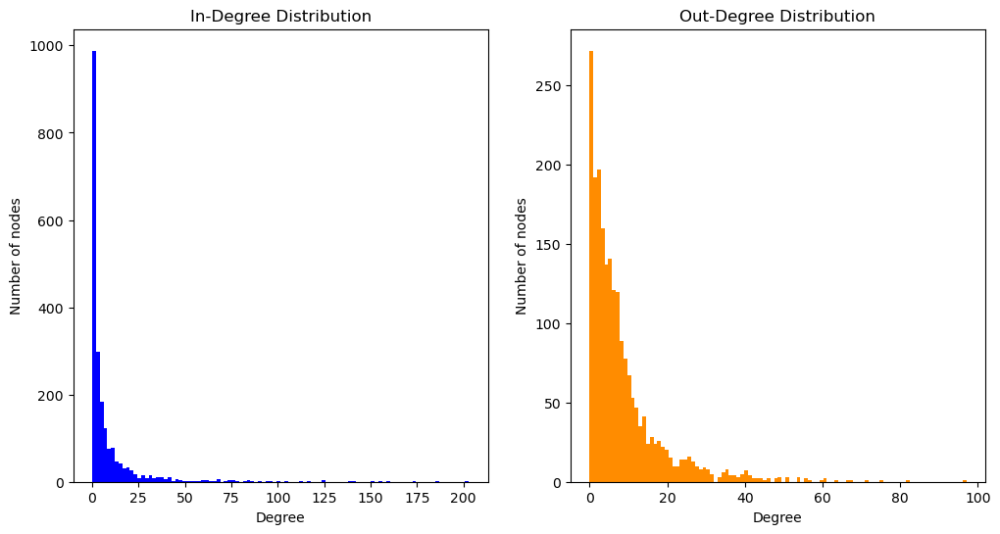

In [207]:
in_degrees = [d for n, d in G.in_degree()]
out_degrees = [d for n, d in G.out_degree()]

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.hist(in_degrees, bins=100, color='blue')
plt.title('In-Degree Distribution')
plt.xlabel('Degree')
plt.ylabel('Number of nodes')

plt.subplot(1, 2, 2)
plt.hist(out_degrees, bins=100, color='darkorange')
plt.title('Out-Degree Distribution')
plt.xlabel('Degree')
plt.ylabel('Number of nodes')

plt.show()

If we compare the out-degree of this network with the out-degree of a completely random directed network we would see major diffences. The degree distribution of a random network follows a poisson distribution, where the degree of most nodes is close to the average and there are not many nodes with extremely low or high degree. We can double check it by ploting the out-degree distribution of a random network with the same number of nodes and edges.

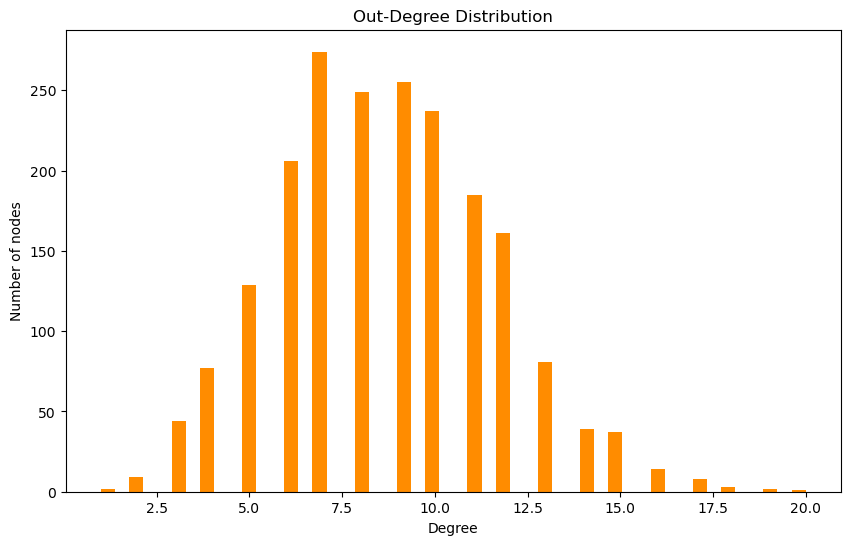

In [208]:
D = nx.gnm_random_graph(2013, 17509, directed=True)

out_degrees_D = [d for n, d in D.out_degree()]

plt.figure(figsize=(10, 6))
plt.hist(out_degrees_D, bins=50, color='darkorange')
plt.title('Out-Degree Distribution')
plt.xlabel('Degree')
plt.ylabel('Number of nodes')

plt.show()

On the other hand, if we compared the in-degree distribution with a scale free network with the same number of nodes, we would see that the distributions are almost identical, as the scale free network also follows a power law distribution. In the plot below, we can see a log-log scale, where if we exclude the few nodes on the bottom right corner with high in-degree that can be considered as hubs, the rest of the nodes form an approximate straight line, suggesting that they indeed follow a power law distribution like the scale free network.

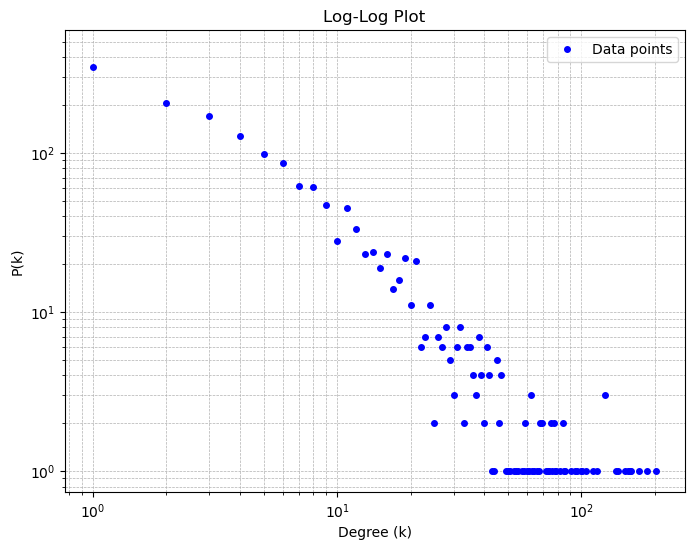

In [209]:
degree_counts = np.bincount(in_degrees)
degree_values = np.arange(len(degree_counts))

plt.figure(figsize=(8, 6))
plt.loglog(degree_values, degree_counts, 'bo', markersize=4, label="Data points")

plt.title("Log-Log Plot")
plt.xlabel("Degree (k)")
plt.ylabel("P(k)")
plt.grid(True, which="both", linestyle="--", linewidth=0.5)
plt.legend()
plt.show()

Next, we can see the performers with the most in and out degree. In the top 5 of in-degree there are some very famous performers such as Elvis Presley, Johnny Cash and Dolly Parton. This is expected, as performers with a high in-degree can be considered very popular and their names are referenced frequently on other performers' pages.

In [210]:
in_degree = dict(G.in_degree())
out_degree = dict(G.out_degree())

top_5_in = sorted(in_degree.items(), key=lambda x: x[1], reverse=True)[:5]
top_5_out = sorted(out_degree.items(), key=lambda x: x[1], reverse=True)[:5]

print("Top 5 Performers by in-degree:")
for performer, in_degree in top_5_in:
    print(f"{performer}: {in_degree}")

print("\nTop 5 Performers by out-degree:")
for performer, out_degree in top_5_out:
    print(f"{performer}: {out_degree}")

Top 5 Performers by in-degree:
Willie_Nelson: 203
Johnny_Cash: 185
Elvis_Presley: 173
Dolly_Parton: 160
Merle_Haggard: 159

Top 5 Performers by out-degree:
Hillary_Lindsey: 97
Pam_Tillis: 82
Randy_Travis: 75
Vince_Gill: 71
Patty_Loveless: 67


Now, in order to find the length of each performer's page, we are going to use the list from before, where we store all the information from the API. Once again, we are using findall to count the words of each page. It will not be completely accurate, since as we said previously there are some performers that use another name from the one in the list of "country music performers" and thus no information could be found through their API.

In [211]:
content_size = []

for performer, content in performer_text.items():
    words = re.findall(r'\w+', content)
    content_size.append((performer,len(words)))
    
content_size

[('3_of_Hearts_(band)|3_of_Hearts', 774),
 ('4_Runner', 2788),
 ('8_Ball_Aitken', 1344),
 ('The_Abrams_Brothers', 24),
 ('Ace_in_the_Hole_Band', 2969),
 ('Roy_Acuff', 6106),
 ('Kay_Adams_(singer)|Kay_Adams', 1729),
 ('Ryan_Adams', 11211),
 ('Doug_Adkins', 1723),
 ('Trace_Adkins', 6935),
 ('David_"Stringbean"_Akeman', 2550),
 ('Rhett_Akins', 3320),
 ('Alabama_(band)|Alabama', 44304),
 ('Lauren_Alaina', 9323),
 ('Jason_Aldean', 11176),
 ('Alee_(singer)|Alee', 1597),
 ('Daniele_Alexander', 906),
 ('Jessi_Alexander', 1189),
 ('Gary_Allan', 4888),
 ('Susie_Allanson', 911),
 ('Deborah_Allen', 2288),
 ('Duane_Allen', 794),
 ('Harley_Allen', 1246),
 ('Jimmie_Allen', 5715),
 ('Rex_Allen', 2605),
 ('Terry_Allen_(country_singer)|Terry_Allen', 203),
 ('Allman_Brothers_Band', 26),
 ('Gregg_Allman', 11176),
 ('Tommy_Alverson', 1083),
 ('Dave_Alvin', 3317),
 ('Amazing_Rhythm_Aces', 31),
 ('American_Young', 1037),
 ('Don_Amero', 1719),
 ('Colin_Amey', 1258),
 ('Al_Anderson_(NRBQ)|Al_Anderson', 1047),


The top 10 performers with the longest wiki entries are displayed below.

In [212]:
top_10_content = sorted(content_size, key=lambda x: x[1], reverse=True)[:10]

print("Top 10 Performers by length of wiki page:")
for performer, content in top_10_content:
    print(f"{performer}: {content}")

Top 10 Performers by length of wiki page:
Taylor_Swift: 56848
Miley_Cyrus: 51750
Justin_Bieber: 51170
Carrie_Underwood: 45919
Justin_Timberlake: 45205
Demi_Lovato: 44508
Alabama_(band)|Alabama: 44304
Bob_Dylan: 41806
Ed_Sheeran: 36819
Elvis_Presley: 34565


We can also see the in and out degree of these top 10 performers, but with a quick look there is not a very strong correlation between length and the degrees.

In [213]:
for performer in top_10_content:
    in_top10 = [d for n, d in G.in_degree(performer)]
    out_top10 = [d for n, d in G.out_degree(performer)]
    print(f"{performer}: in-degree:{in_top10} and out-degree:{out_top10}")

('Taylor_Swift', 56848): in-degree:[77] and out-degree:[27]
('Miley_Cyrus', 51750): in-degree:[17] and out-degree:[11]
('Justin_Bieber', 51170): in-degree:[15] and out-degree:[11]
('Carrie_Underwood', 45919): in-degree:[68] and out-degree:[61]
('Justin_Timberlake', 45205): in-degree:[12] and out-degree:[14]
('Demi_Lovato', 44508): in-degree:[9] and out-degree:[7]
('Alabama_(band)|Alabama', 44304): in-degree:[26] and out-degree:[24]
('Bob_Dylan', 41806): in-degree:[141] and out-degree:[21]
('Ed_Sheeran', 36819): in-degree:[14] and out-degree:[8]
('Elvis_Presley', 34565): in-degree:[173] and out-degree:[21]


Moving to the network visualization, we first have to convert the previous network (G) to an undirected network. Then, we have to collect the total degree of each node as it will be used as the node size later. The average node degree is ~14 so if we use a multiplier of 1.5 the average node size would be also around 20, which is pretty good visually (we tested some other multipliers but it gets messy when >2).

In [214]:
G_undirected = G.to_undirected()

node_degrees = dict(G_undirected.degree())

print(sum(node_degrees.values()) / len(node_degrees))

list_of_sizes = [degree * 1.5 for degree in node_degrees.values()]

14.082738944365193


The node color depends on the length of the performers' wiki page. We will use a reversed blues scale, where the dark blue means small number of word count and light blue to white means high word count. This way it is easy to distinguish all the nodes.

In [215]:
node_sizes = dict(content_size).values()

norm = mpl.colors.Normalize(vmin=min(node_sizes), vmax=max(node_sizes))

cmap = plt.cm.Blues_r
node_colors = [cmap(norm(size)) for size in node_sizes]


Finally, we visuallize the netowrk. There is a giant component in the middle, where most hubs (popular performers) are located. Another thing that can be noticed is that most of the light blue colored nodes are towards the middle and are bigger than the average. This suggests that performers with long wiki entries are more likely to be connected with other performers and this is completely normal, since if a performer has a long wiki page, he probably has many accomplishments and collaborations with other singers. Thus, there is a high probability of having other performers' names (links) inside their page. 

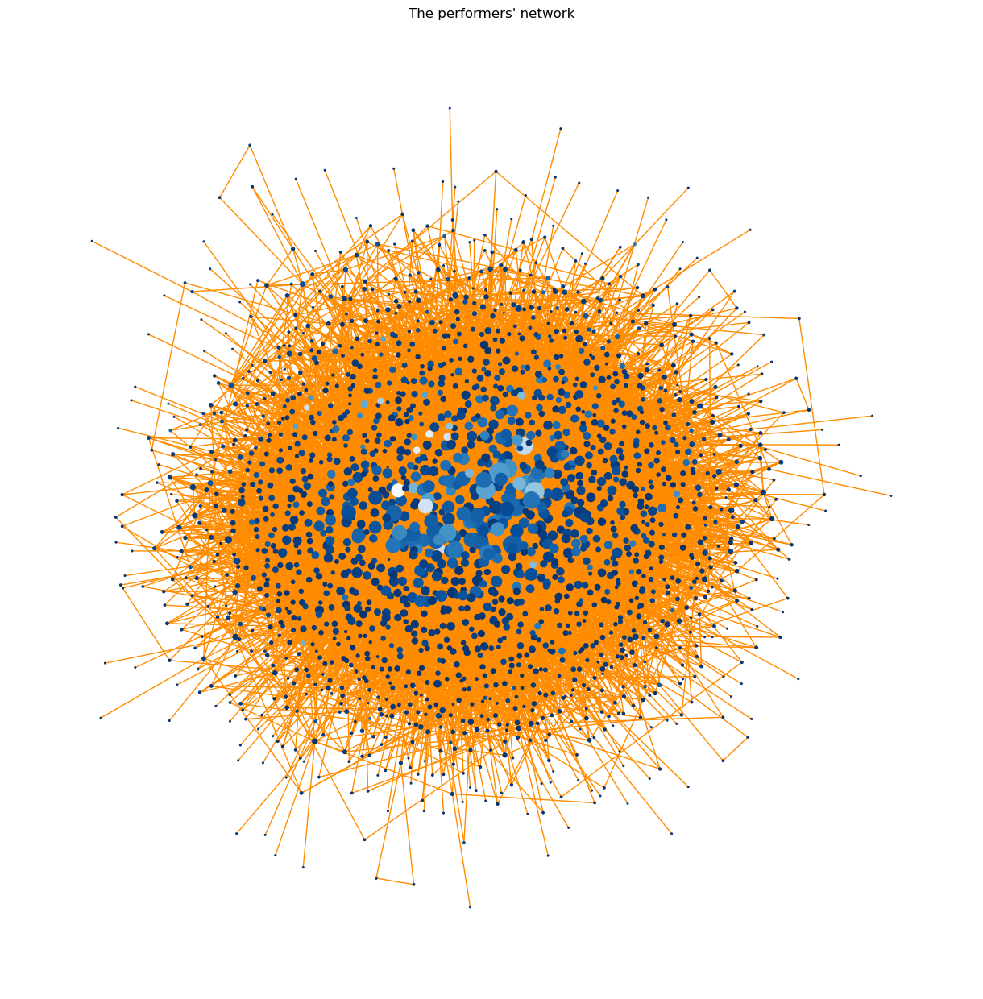

In [216]:
plt.figure(figsize=(12, 12))
nx.draw(G_undirected, nx.kamada_kawai_layout(G_undirected), with_labels=False, node_color= node_colors, edge_color='darkorange', node_size= list_of_sizes)
plt.title("The performers' network")
plt.show()